In [1]:
from lightning.pytorch.loggers import WandbLogger
import pathlib as pb
import sys
import os
os.chdir('..')

In [2]:
%load_ext autoreload
%autoreload 2

In [8]:
if (p := pb.Path(os.getcwd())) not in sys.path:
    sys.path.append(str(p))

from gic import *
from gic.data.dataset import GICDataset
from gic.data.dataloader import GICDataLoader
from gic.learning.autoencoder.wrappers import DAEModule
from gic.learning.autoencoder.callbacks import ReconstructVizCallback
from gic.data.transform import tr_preprocess

In [4]:
loader = GICDataLoader(DATA_PATH, 32)
logger = WandbLogger(project=PROJECT_NAME, name=f'DAE', save_dir=LOG_PATH)
trainer = tl.Trainer(max_epochs=100, logger=logger, callbacks=[ReconstructVizCallback()])
model = DAEModule(chan=48, lowdim=256, layers=2, drop_input=0.25, drop_inside=0.0)
model

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


DAEModule(
  (autoencoder): DenoisingAutoEncoder(
    (encoder): DenoisingEncoder(
      (in_layer): InputModule(
        (dropout): Dropout(p=0.25, inplace=False)
        (conv_layer): Conv2d(3, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (norm_layer): LayerNorm((48, 64, 64), eps=1e-05, elementwise_affine=True)
        (actv_layer): SiLU()
      )
      (layers): Sequential(
        (0): ConvModule(
          (dropout): Dropout(p=0.0, inplace=False)
          (conv_layer): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (norm_layer): LayerNorm((48, 64, 64), eps=1e-05, elementwise_affine=True)
          (actv_layer): SiLU()
        )
        (1): EncodeModule(
          (dropout): Dropout(p=0.0, inplace=False)
          (pool_layer): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
          (conv_layer): Conv2d(48, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (norm_layer): LayerNorm((96, 

In [5]:
trainer.fit(model, datamodule=loader)

wandb: Currently logged in as: invokariman (castelvaar). Use `wandb login --relogin` to force relogin


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name        | Type                 | Params
-----------------------------------------------------
0 | autoencoder | DenoisingAutoEncoder | 52.4 M
1 | _loss       | L1Loss               | 0     
-----------------------------------------------------
52.4 M    Trainable params
0         Non-trainable params
52.4 M    Total params
209.704   Total estimated model params size (MB)


Epoch 99: 100%|██████████| 352/352 [00:06<00:00, 57.23it/s, v_num=itsd]    

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 99: 100%|██████████| 352/352 [00:07<00:00, 50.27it/s, v_num=itsd]


In [6]:
model.eval()
model.requires_grad_(False)

DAEModule(
  (autoencoder): DenoisingAutoEncoder(
    (encoder): DenoisingEncoder(
      (in_layer): InputModule(
        (dropout): Dropout(p=0.25, inplace=False)
        (conv_layer): Conv2d(3, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (norm_layer): LayerNorm((48, 64, 64), eps=1e-05, elementwise_affine=True)
        (actv_layer): SiLU()
      )
      (layers): Sequential(
        (0): ConvModule(
          (dropout): Dropout(p=0.0, inplace=False)
          (conv_layer): Conv2d(48, 48, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (norm_layer): LayerNorm((48, 64, 64), eps=1e-05, elementwise_affine=True)
          (actv_layer): SiLU()
        )
        (1): EncodeModule(
          (dropout): Dropout(p=0.0, inplace=False)
          (pool_layer): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
          (conv_layer): Conv2d(48, 96, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (norm_layer): LayerNorm((96, 

In [61]:
data = GICDataset(DATA_PATH, 'train')
model = model.to(DEVICE)
e = []

for i in range(len(data)):
    X, _ = data[i]
    x = model.autoencoder.encoder(tr_preprocess(X.unsqueeze(0).to(DEVICE)))
    l = model.autoencoder.bottleneck(x)[1]
    e.append(l.cpu())
e = torch.cat(e, dim=0).flatten(1)

In [68]:
data_valid = GICDataset(DATA_PATH, 'valid')
model = model.to(DEVICE)
e_valid = []

for i in range(len(data_valid)):
    X, _ = data[i]
    x = model.autoencoder.encoder(tr_preprocess(X.unsqueeze(0).to(DEVICE)))
    l = model.autoencoder.bottleneck(x)[1]
    e_valid.append(l.cpu())
e_valid = torch.cat(e_valid, dim=0).flatten(1)

In [79]:
from sklearn.svm import SVC, LinearSVC


svm = SVC(C=100)
svm.fit(e.numpy(), data.data_['Class'].to_numpy())

SVC(C=100)

In [80]:
y_hat = svm.predict(e_valid.numpy())

In [81]:
from sklearn.metrics import f1_score


f1_score(data_valid.data_['Class'].to_numpy(), y_hat, average='macro')

0.00912079543184607

In [82]:
y_hat == data_valid.data_['Class'].to_numpy()

array([False, False, False, ..., False, False, False])

: 

In [17]:
e.shape

torch.Size([13000, 256])

In [18]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=100)
kmeans.fit(e)

/home/invokariman/.cache/pypoetry/virtualenvs/gic-BfYgXNhZ-py3.11/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=100)

In [32]:
groups = {}

for i, l in zip(range(len(data)), kmeans.labels_):
    data.data_.iloc[i]
    if l not in groups.keys():
        groups[l] = []
    groups[l].append(data.data_.iloc[i]['Image'])

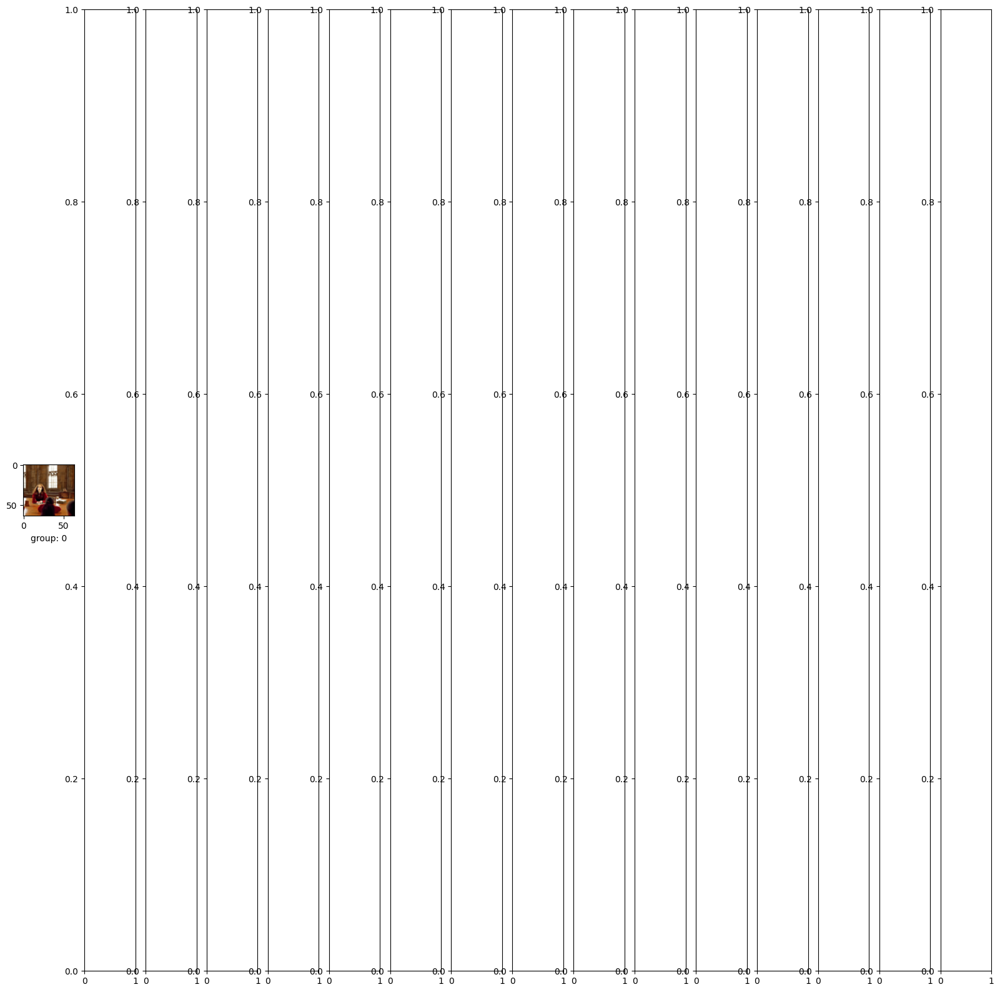

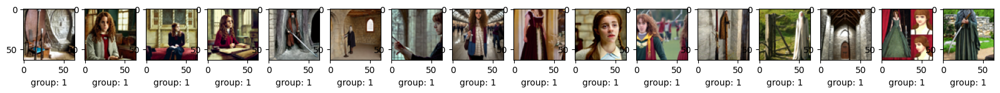

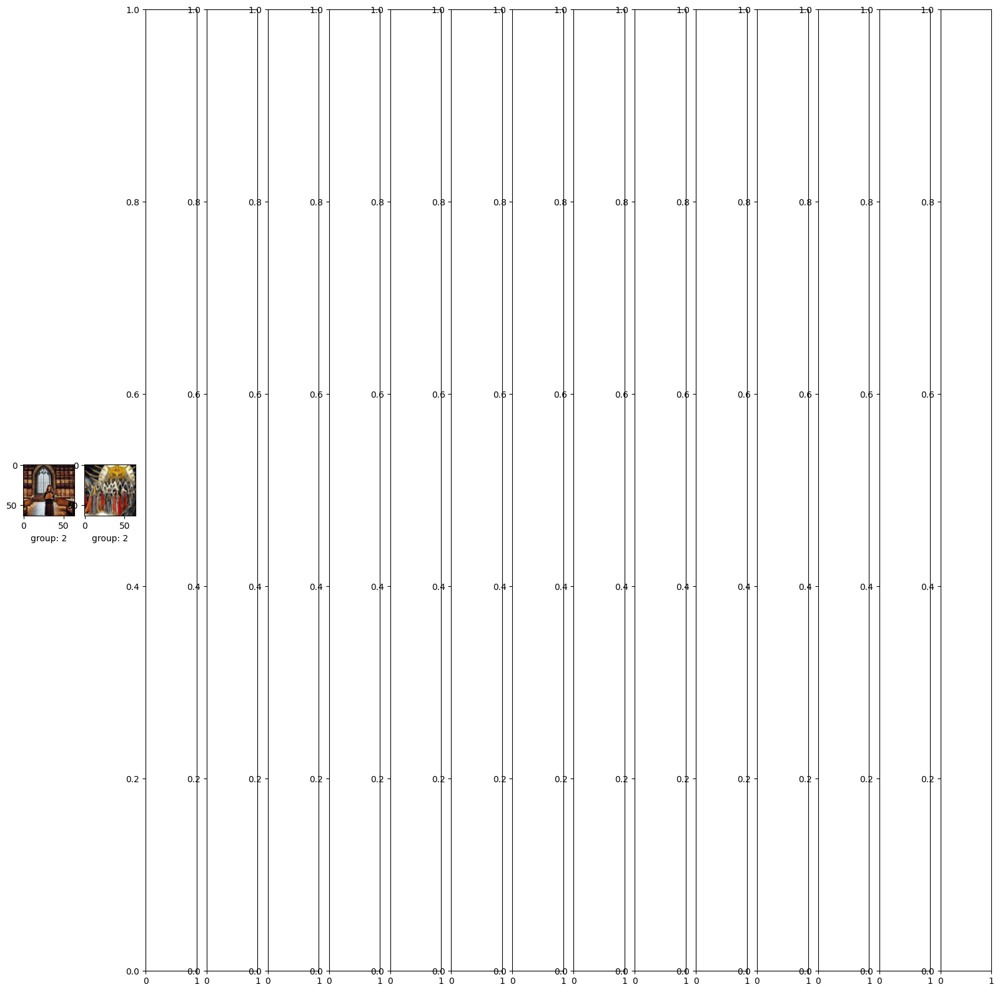

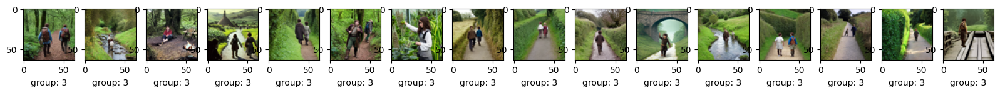

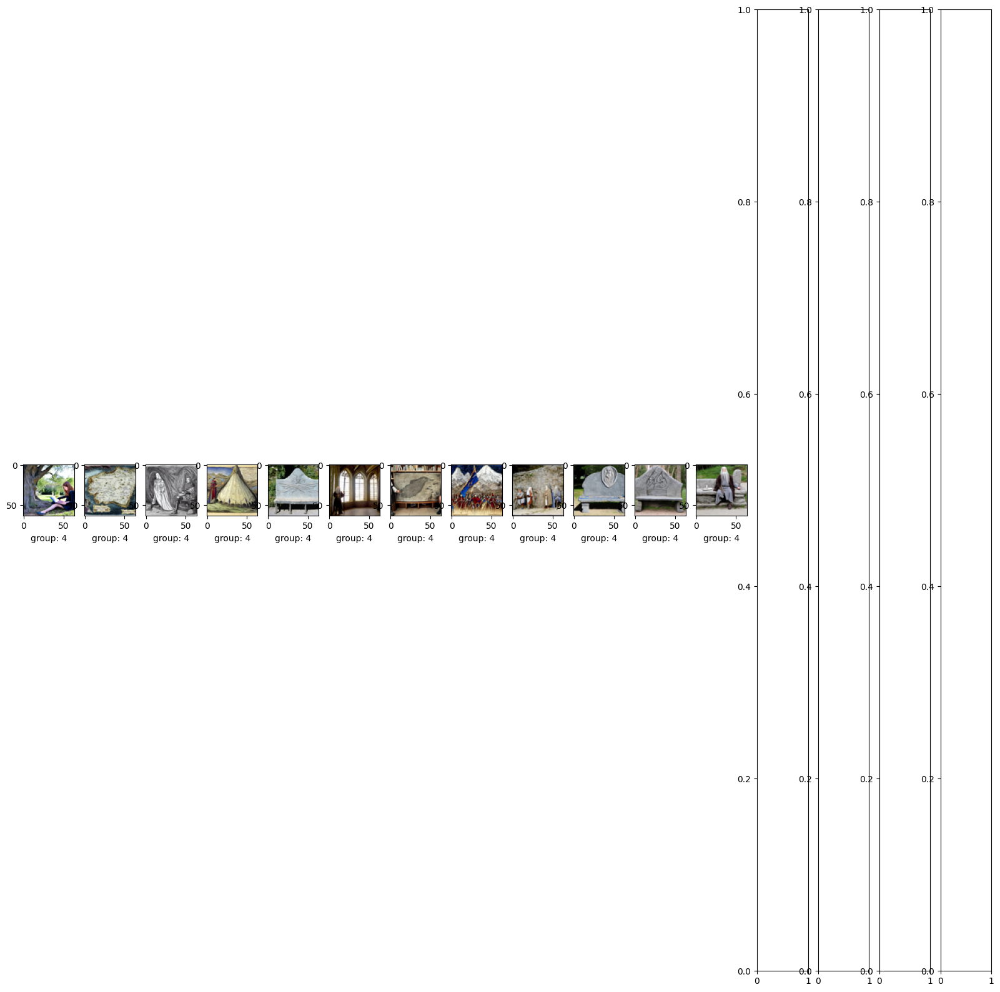

...

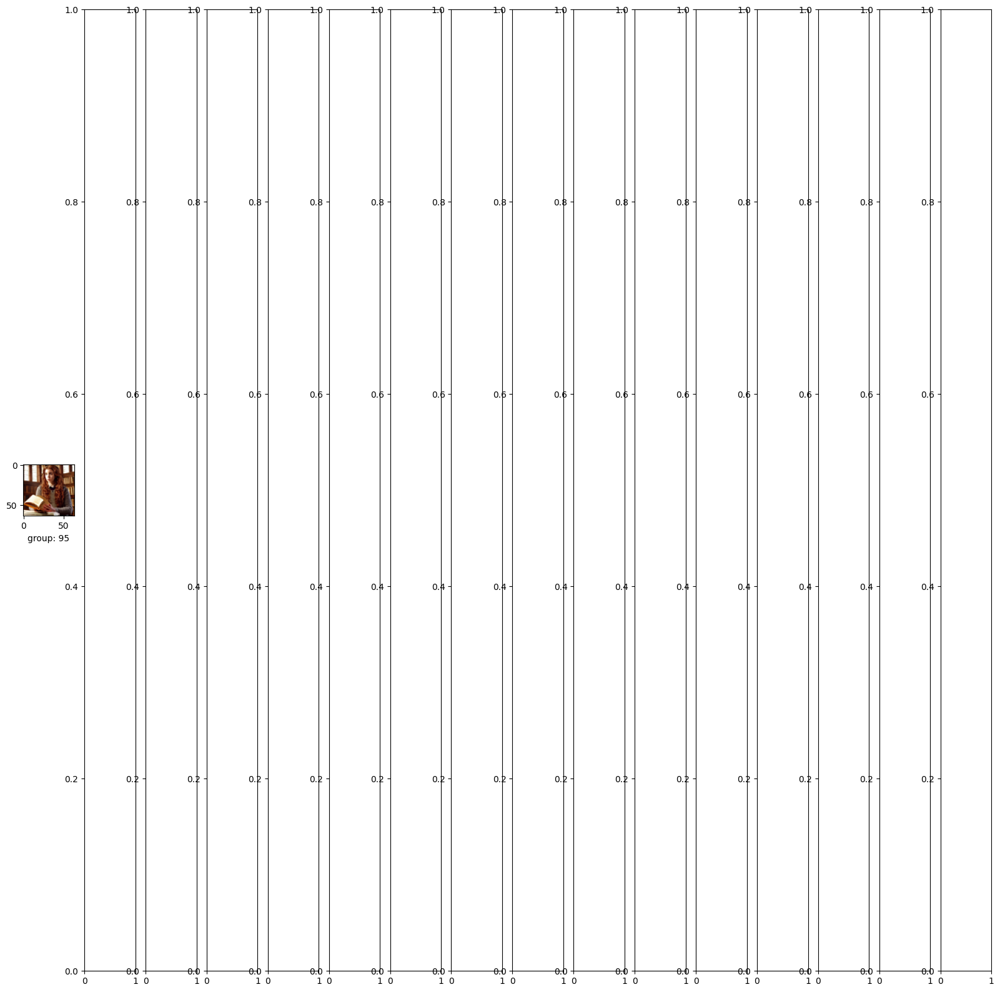

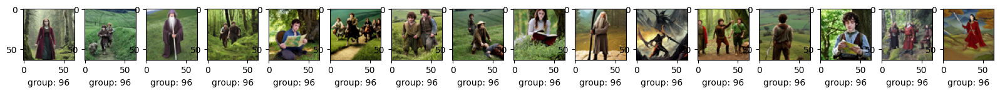

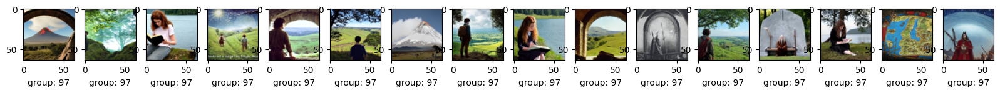

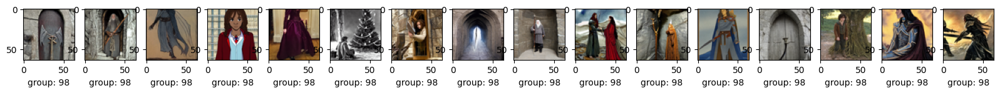

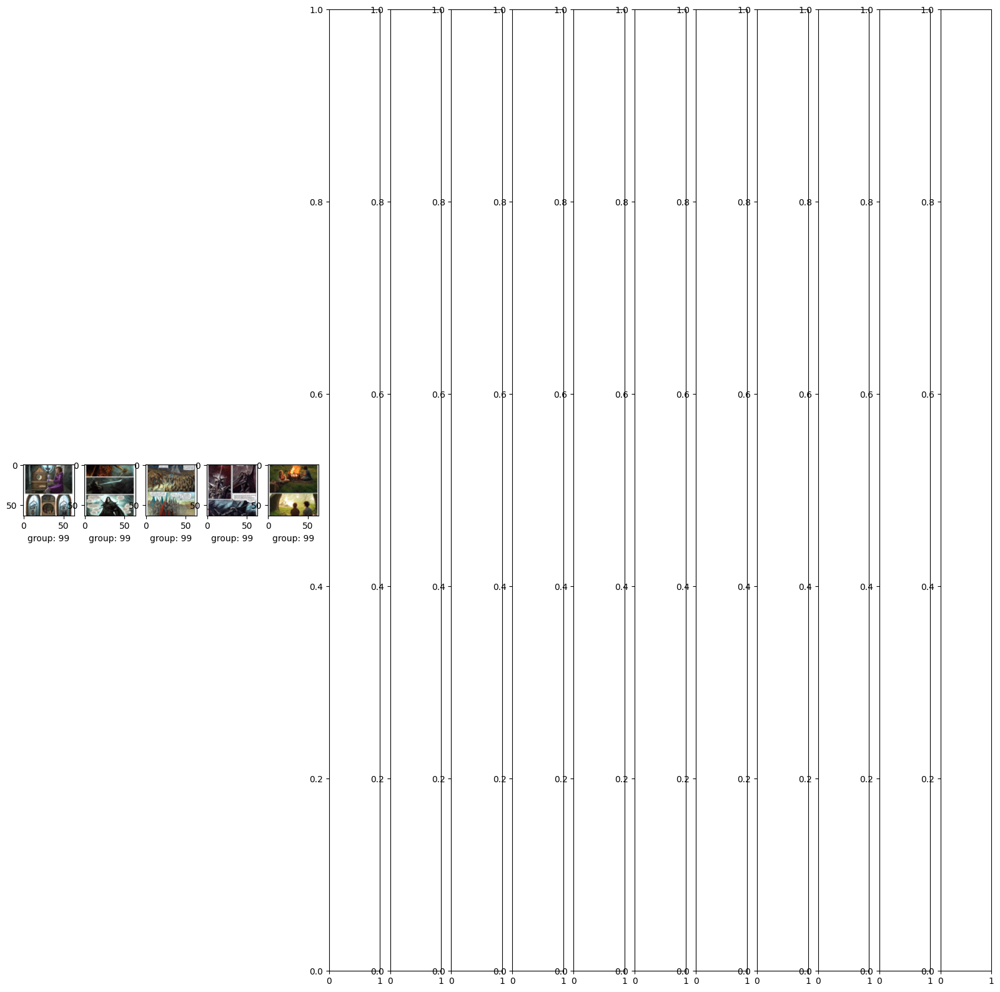

In [45]:
from PIL import Image
import matplotlib.pyplot as pt

for i, (g, imgs) in enumerate(sorted(groups.items(), key=lambda x: x[0])):
    f, ax = pt.subplots(1, 16, figsize=(20, 20))
    for j in range(min(16, len(imgs))):
        with Image.open(DATA_PATH / 'train_images' / imgs[j]) as img:
            ax[j].set_xlabel(f'group: {g}')
            ax[j].imshow(img)
    pt.show()